In [1]:
import ruptures as rpt
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pybedtools
import time
import math

In [66]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-

#Scrip to remove artifacts.
import pandas as pd
import numpy as np
import pybedtools
import matplotlib.pyplot as plt

#Creates a bed file from an array
def create_bed_from_array(array):

    data_array = []
    if len(array) % 2 != 0:
        array=array[:-1] #Remove last value
    for i in range(0, len(array), 2):
        data_array.append(["PA_chr01", array[i],array[i+1]])
    np_array = np.array(data_array)
    dataframe = pd.DataFrame(np_array)
    return pybedtools.BedTool.from_dataframe(dataframe)

#Removes exact matches from an array
def remove_artifacts_exact(reference, individual):
    ref_set = set(ref)
    deletions = [x for x in ind1 if x not in ref_set]
    return deletions

#Removes matches in a window, w=1000 is the extension of the window.
def remove_artifacts_window(ref_bed, ind_bed):
    ind5_bkps_bed = pybedtools.BedTool(ind_bed)
    ref_bkps_bed = pybedtools.BedTool(ref_bed)
    return ind5_bkps_bed.subtract(ref_bkps_bed, f=0.6, r=True, A=True )#

def bed_to_array(bed):
    # df=pd.read_csv('removed_artifacts_pred.bed',header=None, sep='\t')
    # col_one_arr = df[1].to_numpy()
    # col_two_arr = df[2].to_numpy()
    # start_stop=np.array([0,size])
    # arr = np.concatenate((col_one_arr, col_two_arr))
    # arr = np.concatenate((arr, start_stop))

    # arr=np.sort(arr)
    return pybedtools.BedTool.to_dataframe(bed).loc[:, ["start", "end"]].to_numpy().flatten()

#Filter and remove artifacts
def pred_breakpoints_remove_artifacts(ref_arr, pred_arr, coverage_array, thr):
        filter_arr=filter_coverage(pred_arr, thr, coverage_array) #Filter some threshold
        
        pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        ref_bed=create_bed_from_array(ref_arr)
        rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        return pred_filtred_bed #rem_pred_filter #
    
def pred_breakpoints(pred_arr, coverage_array, ref_arr):
        filter_arr=filter_coverage(pred_arr, coverage_array) #Filter some threshold
        
        if len(filter_arr)!=0:
            pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
            ref_bed=create_bed_from_array(ref_arr)
            rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
            return rem_pred_filter #pred_filtred_bed #
        else: 
            return None

def filter_coverage(pred_array, coverage_array):
    avg_cov_arr=[]
    pred_filterd=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]

        temp=coverage_array[start: stop]

        avg_coverage=sum(temp)/len(temp)
        avg_cov_arr.append(avg_coverage)
        
    (n, bins, patches) = plt.hist(avg_cov_arr, bins=25) 
    print("threshold: ")
    print(bins[1])
    plt.show()
    
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]

        if avg_cov_arr[i]<(bins[1]):
            pred_filterd.extend([start, stop])  
   
    return pred_filterd, bins[1]


In [3]:
def extract_data(path, row): 
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    individual=np.array(data[row])

    #Extract the reference
    reference=np.array(data[2])
    return individual, reference 

In [4]:
def window(individual, reference, pen_ind, pen_ref, width, min_size): 

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"

    #Fit the data - uncommet this to try different models
    algo = rpt.Window(width=width, model=model, min_size=min_size).fit(individual)
    algo_ref = rpt.Window(width=width, model=model, min_size=min_size).fit(reference)

    #Predict the breakpoints for the individual and reference
    ind_bkps = algo.predict(pen=pen_ind) 
    ref_bkps = algo_ref.predict(pen=pen_ref)
    return ind_bkps, ref_bkps

In [5]:
def bottomUp(individual, reference, pen_ind, pen_ref, min_size): 

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"

    #Fit the data - uncommet this to try different models
    algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)
    algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)

    #Predict the breakpoints for the individual and reference
    ind_bkps = algo.predict(pen=pen_ind)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    return ind_bkps, ref_bkps

In [6]:
# Show the data
def display_data(individual, ind_bkps, reference, ref_bkps):
    rpt.display(individual, ind_bkps, figsize=(100, 6))
    plt.title('Before filtering and artifacts removal')
    plt.show()

    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()

In [7]:
def display_filtered_old(ref_bkps , ind_bkps, individual): 
    rem_pred_filter=pred_breakpoints(ref_bkps , ind_bkps, individual)
    rem_pred_filter_arr=bed_to_array(rem_pred_filter)
   # true_bkps_arr=bed_to_array(true_bkps_bed)
    rpt.display(individual, rem_pred_filter_arr, figsize=(100, 6))
    plt.title('After filtering')
    plt.show()
    return rem_pred_filter

In [8]:
def display_filtered(ind_bkps, individual, ref_bkps): 
    rem_pred_filter=pred_breakpoints(ind_bkps, individual, ref_bkps)
    
    if rem_pred_filter is None :
        plt.figure(figsize=(100, 6))
        plt.plot(individual)
        plt.show()
       
    else: 
        rem_pred_filter_arr=bed_to_array(rem_pred_filter)
       # true_bkps_arr=bed_to_array(true_bkps_bed)
        rpt.display(individual, rem_pred_filter_arr, figsize=(100, 6))
        plt.title('After filtering')
        plt.show()
        return rem_pred_filter
        

In [9]:
#Extract data
#individual, reference=extract_data('1mil', 5)
individual_2mil, reference_2mil=extract_data('2mil', 5)

In [10]:
def calculate_avg_thr(path):
    avg_thr=[]
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    for i in range(len(data.columns)-2):
        avg_thr.append(3*np.mean(np.array(data[i+2])))
    return avg_thr



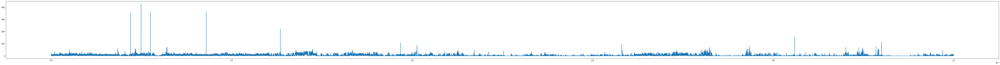

In [11]:
s, r= extract_data('10mil', 9)
plt.figure(figsize=(100,6))
plt.plot(s)

[111.2134613, 107.63616529999999, 27.9573035, 29.724108700000002, 33.6706412, 25.6870093, 31.264682, 18.203745599999998, 21.9490434, 20.2713991, 24.4085848, 19.8881604, 16.8571126, 17.757649, 18.981129799999998, 22.2121067, 18.5452415, 19.9329885, 19.3886059, 19.5848022]
20


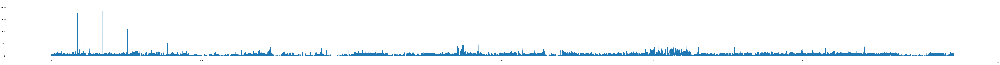

In [12]:
s, r= extract_data('30mil', 9)
plt.figure(figsize=(100,6))
plt.plot(s)

arr=calculate_avg_thr('30mil')
print(arr)
print(len(arr))

In [48]:
arr=calculate_avg_thr('10mil')
print(arr)
print(len(arr))

[100.9527267, 98.5067502, 19.8583113, 19.8014646, 23.732220899999998, 17.117094599999998, 25.833576900000004, 12.8712801, 21.0638781, 20.3519544, 19.5289866, 11.777042999999999, 10.7172129, 10.9871175, 15.247160099999999, 12.866535299999999, 15.9943248, 12.853956, 11.8154109, 17.8426494]
20


In [13]:
def calc_all_col_pelt(path, pen_ref, pen_ind, threshold, jump): 
    col=3
    data=pd.read_csv(path, header=None, sep='\t')
    
    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100
    #pen_ref=10**5
    #pen_ind=10**5
    #Extract the reference
    reference=np.array(data[2])
    reference[reference > 100 ] = 100
    t0 = time.time()
    algo_ref = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(reference)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    t1 = time.time()
    print("Reference: ")
    print(t1-t0)
    
    
    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()
    
    #Extract the individual sample
    while col < len(data.columns):
        individual=np.array(data[col])
        individual[individual > 50 ] = 50
         #Fit the data - uncommet this to try different models
        t0 = time.time()
        algo = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(individual)
   
        #Predict the breakpoints for the individual and reference
        ind_bkps = algo.predict(pen=pen_ind)
        t1 = time.time()
        print("Sample:" + str(col))
        print(t1-t0)
        display_filtered(ind_bkps, individual, threshold)
        
        col=col+1

In [40]:
calc_all_col_pelt('2mil', 10**3, 10**3, 1, 100)

KeyboardInterrupt: 

In [71]:
    #smallest deletion
        #Biggest deletion 
        #Number of deletions 
        #avg lenght of deletions 

def create_info_array(bedObject):
        info=[]
        for feature in bedObject:
            info.append(feature.stop-feature.start)
        min_info=np.min(info)
        max_info=np.max(info)
        avg_info=np.mean(info)
        len_info=len(info)
        return min_info, max_info, avg_info, len_info



In [76]:
def calc_all_col(path, pen_ref, pen_ind, arr_avg_cov, ref_index, sample_index='all'): 
    
    data=pd.read_csv(path, header=None, sep='\t')
    
    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100
    
    #Extract the reference
    
    all_ref=[]
    
    for index in ref_index: 
       
        reference=np.array(data[index])
        reference[reference > arr_avg_cov[index-2]] = arr_avg_cov[index-2]
        t0 = time.time()
        algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        print("Reference "+str(index)+": ")
        print(t1-t0)

        (filter_array_ref, threshold)=filter_coverage(ref_bkps, reference) #Filter the reference 
        all_ref.extend(filter_array_ref)
        
        #get info 
        ref_bed_1=create_bed_from_array(filter_array_ref) #create bed file and save it  
        (min_info, max_info, avg_info, len_info)=create_info_array(ref_bed_1)

        #Write to file
        info_file = open("results/info_reference_" + str(index) + ".txt", "w")

        info_file.write("This is a file containing information about reference with index " + str(index) + ". \n")
        info_file.write("Smallest artifact: " + str(min_info) + "\n")    
        info_file.write("Biggest artifact: " + str(max_info) + "\n")   
        info_file.write("Average artifact: " + str(avg_info)+ "\n")
        info_file.write("Number of artifacts: " + str(len_info)+ "\n")
        info_file.write("Artifact threshold: " + str(threshold)+ "\n")
        info_file.write("Average coverage * 3 cut off: " + str(arr_avg_cov[index-2]) + "\n")
        info_file.close()
        
    ref_bed=create_bed_from_array(all_ref) #create bed file and save it  
    ref_bed_sort=ref_bed.sort().merge().saveas("results/reference.bed")      
    print(ref_bed_sort)
    
    
    

    
   # rpt.display(reference, all_ref, figsize=(100, 6))
    #plt.title('Reference')
   # plt.show()
    #Extract the individual sample
    
    if sample_index=='all': 
        sample_index=range(2, len(data.columns))
    
    for i in sample_index:
        
        if i not in ref_index: 
            individual=np.array(data[i])
            individual[individual > arr_avg_cov[i-2] ] = arr_avg_cov[i-2]

            #Fit the data 
            t0 = time.time()
            algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i))
            print(t1-t0)

            (filter_array, threshold)=filter_coverage(ind_bkps, individual) #filter the sample
            pred_filtred_bed=create_bed_from_array(filter_array) #create bed file 

           # print(pred_filtred_bed)
            rem_bed=remove_artifacts_window(ref_bed_sort,pred_filtred_bed).saveas("results/sample_" + str(i) + ".bed") # save it
            print(rem_bed)
            #rem_pred_filter_arr=bed_to_array(rem_bed) #Remove reference bkps and convert to array. 

           # rpt.display(individual, rem_pred_filter_arr, figsize=(100, 6))
            #plt.title('Individual' + str(i+1))
           # plt.show()

            print("Coverage cutoff: ")
            print(arr_avg_cov[i-2])
            
            (min_info, max_info, avg_info, len_info)=create_info_array(rem_bed)

            #Write to file
            info_file = open("results/info_sample_" + str(i) + ".txt", "w")

            info_file.write("This is a file containing information about sample with index " + str(i) + ". \n")
            info_file.write("Smallest deletion: " + str(min_info) + "\n")    
            info_file.write("Biggest deletion: " + str(max_info) + "\n")   
            info_file.write("Average deletion: " + str(avg_info)+ "\n")
            info_file.write("Number of deletions: " + str(len_info)+ "\n")
            info_file.write("Deletion threshold: " + str(threshold)+ "\n")
            info_file.write("Average coverage 3 cut off: " + str(arr_avg_cov[i-2]) + "\n")
            info_file.close()



Reference 2: 
24.334429025650024
threshold: 
9.148734972677595


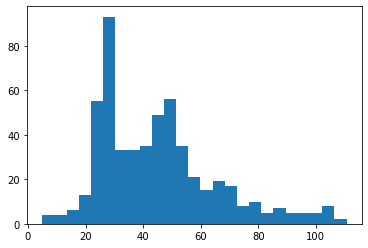

Reference 3: 
23.663381099700928
threshold: 
5.046325641025641


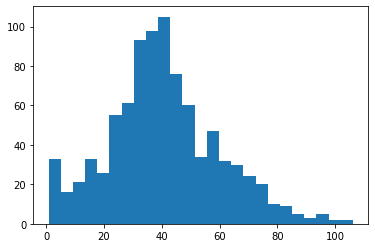

PA_chr01	298825	299555
PA_chr01	510610	514890
PA_chr01	1181390	1183830
PA_chr01	1227165	1245475
PA_chr01	1245600	1269285
PA_chr01	1282465	1283805
PA_chr01	1299800	1300290
PA_chr01	1307120	1307855
PA_chr01	1311640	1315790
PA_chr01	1337515	1351315
PA_chr01	1351560	1351800
PA_chr01	1352165	1359005
PA_chr01	1369255	1376215
PA_chr01	1377070	1380120
PA_chr01	1397575	1407710
PA_chr01	1413815	1420770
PA_chr01	1425045	1488155
PA_chr01	1490960	1503780
PA_chr01	1518915	1523065
PA_chr01	1523675	1542595
PA_chr01	1604975	1605825
PA_chr01	1777460	1779780
PA_chr01	1780145	1782345
PA_chr01	1821525	1825925
PA_chr01	1829100	1834585
PA_chr01	1834710	1890745
PA_chr01	1895865	1896355
PA_chr01	1912590	1927970
PA_chr01	1933830	1945795
PA_chr01	1946040	1953245
PA_chr01	1957760	1961665
PA_chr01	1970820	1971795
PA_chr01	1976560	1978510
PA_chr01	1978870	1989375
PA_chr01	1989615	1998285

Sample:6
24.17426085472107
threshold: 
1.3598807247719846


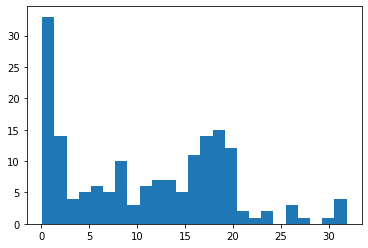

PA_chr01	115960	119495
PA_chr01	166370	197015
PA_chr01	204585	208125
PA_chr01	290275	309685
PA_chr01	342400	357780
PA_chr01	464960	484980
PA_chr01	638790	654535
PA_chr01	663570	665765
PA_chr01	675780	685785
PA_chr01	735590	736200
PA_chr01	759390	776480
PA_chr01	814325	817500
PA_chr01	849965	863400
PA_chr01	893915	895745
PA_chr01	978020	983640
PA_chr01	1018915	1022210
PA_chr01	1031610	1038445
PA_chr01	1041615	1046750
PA_chr01	1069330	1074700
PA_chr01	1076045	1081660
PA_chr01	1109005	1116570
PA_chr01	1210690	1215445
PA_chr01	1227535	1269285
PA_chr01	1559810	1575680
PA_chr01	1576290	1614740
PA_chr01	1615230	1718870
PA_chr01	1719235	1779655
PA_chr01	1780760	1812130

Coverage cutoff: 
33.6706412
Sample:7
23.60924005508423
threshold: 
1.3740123818220042


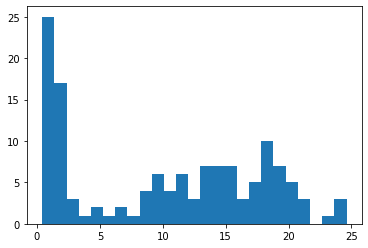

PA_chr01	40520	89225
PA_chr01	141960	147575
PA_chr01	149770	159785
PA_chr01	211540	212760
PA_chr01	271235	274530
PA_chr01	290275	309685
PA_chr01	318960	320670
PA_chr01	381215	386470
PA_chr01	390745	399040
PA_chr01	421505	426265
PA_chr01	429685	436275
PA_chr01	463615	543815
PA_chr01	544675	716425
PA_chr01	903680	911615
PA_chr01	982905	983640
PA_chr01	1019285	1022210
PA_chr01	1041495	1046750
PA_chr01	1069330	1074575
PA_chr01	1559565	1601800
PA_chr01	1603870	1614740
PA_chr01	1615230	1718870
PA_chr01	1719235	1801630

Coverage cutoff: 
25.6870093


In [77]:
calc_all_col('2mil', 10**5, 10**5, arr, [2,3], [6,7])

Reference: 
24.081196069717407
threshold: 
9.148734972677595


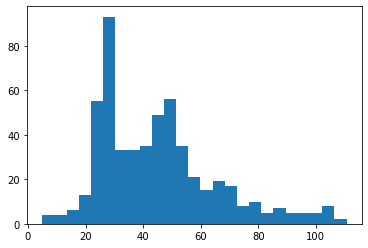

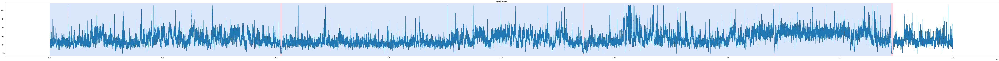

Sample:1
23.875590085983276
threshold: 
5.046325641025641


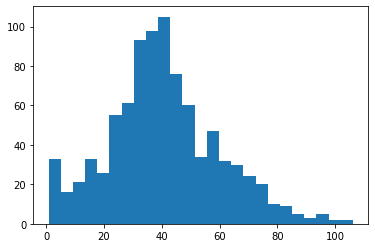

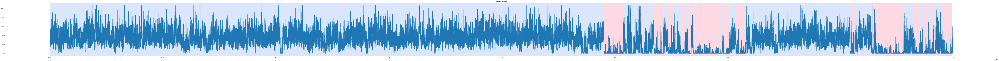

Coverage cutoff: 
107.63616529999999
Sample:2
23.860275983810425
threshold: 
1.1176216160795043


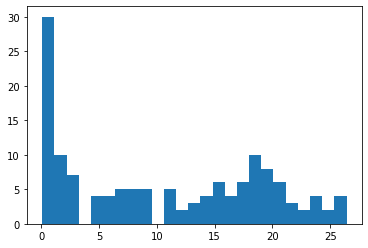

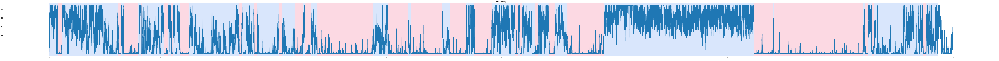

Coverage cutoff: 
27.9573035
Sample:3
23.778290033340454
threshold: 
1.1634976981929588


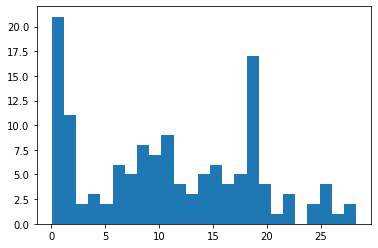

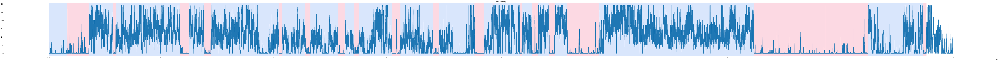

Coverage cutoff: 
29.724108700000002
Sample:4
23.734352111816406
threshold: 
1.3598807247719846


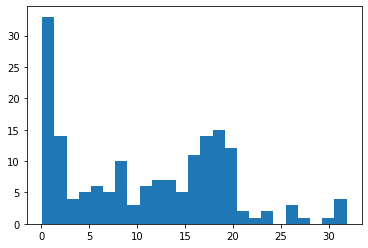

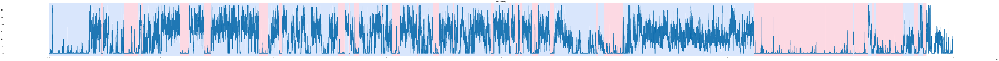

Coverage cutoff: 
33.6706412
Sample:5
23.835330963134766
threshold: 
1.3740123818220042


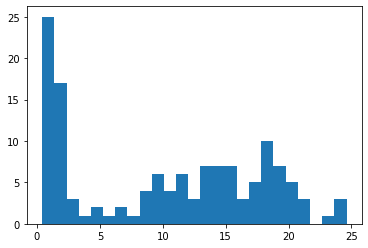

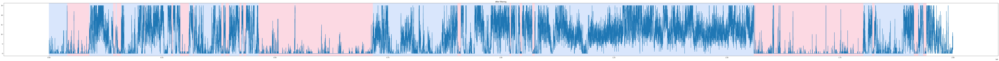

Coverage cutoff: 
25.6870093
Sample:6
23.70449423789978
threshold: 
1.4545819532269397


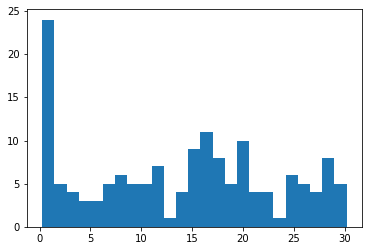

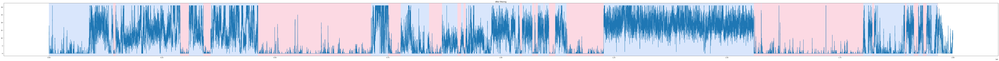

Coverage cutoff: 
31.264682
Sample:7
24.19672203063965
threshold: 
0.8485633590432446


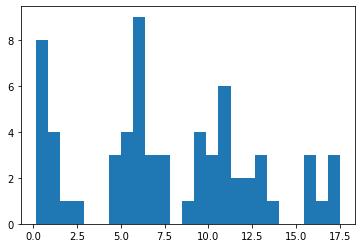

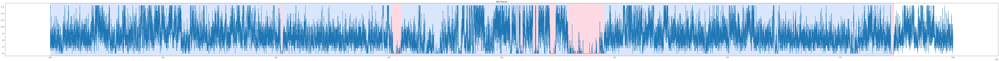

Coverage cutoff: 
18.203745599999998
Sample:8
23.696136951446533
threshold: 
0.9790097022415523


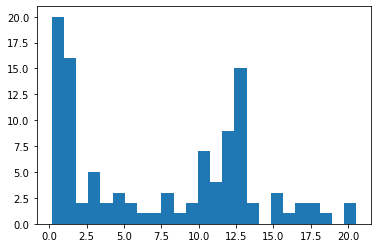

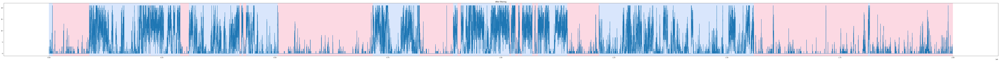

Coverage cutoff: 
21.9490434
Sample:9
23.884073972702026
threshold: 
1.0621390510669761


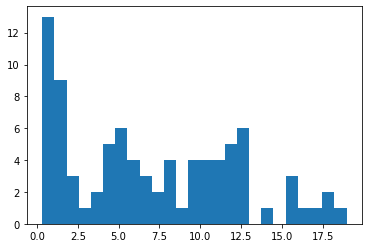

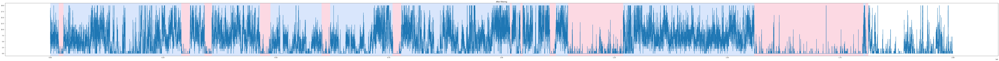

Coverage cutoff: 
20.2713991
Sample:10
23.78512978553772
threshold: 
1.080837578280946


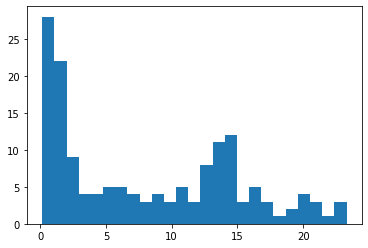

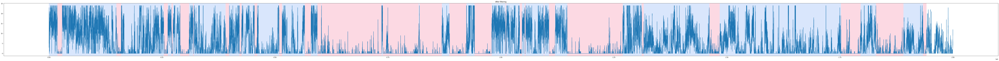

Coverage cutoff: 
24.4085848
Sample:11
23.757961988449097
threshold: 
0.7598789093825181


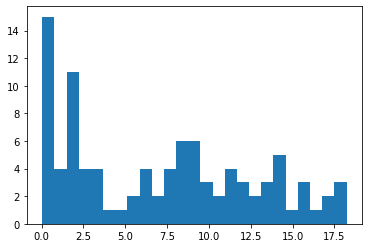

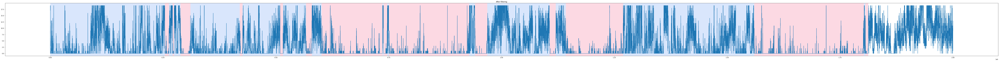

Coverage cutoff: 
19.8881604
Sample:12
23.917989015579224
threshold: 
0.7787726913402804


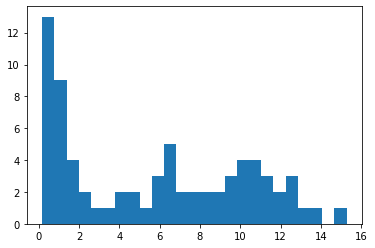

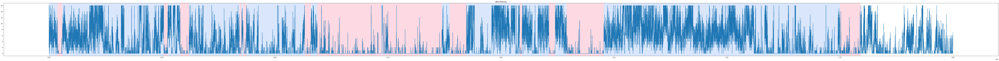

Coverage cutoff: 
16.8571126
Sample:13
23.8004732131958
threshold: 
0.7833727696914827


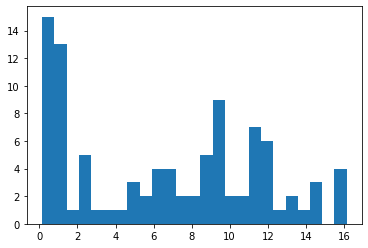

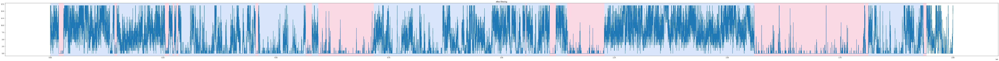

Coverage cutoff: 
17.757649
Sample:14
23.784138917922974
threshold: 
0.6570318664643399


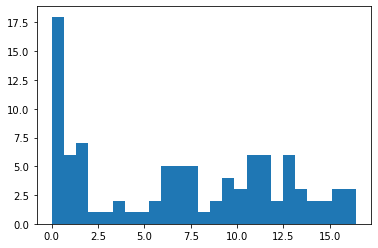

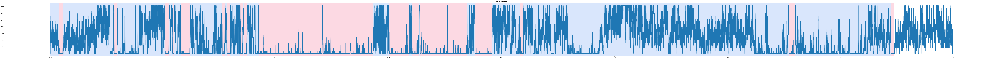

Coverage cutoff: 
18.981129799999998
Sample:15
23.800917863845825
threshold: 
1.0123207299595165


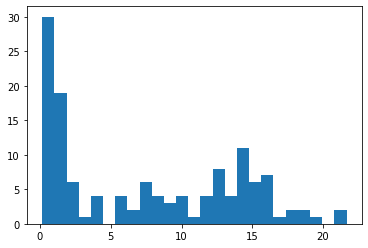

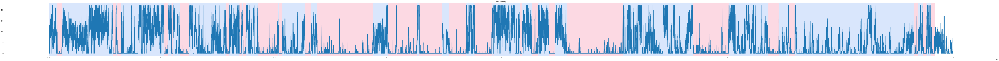

Coverage cutoff: 
22.2121067
Sample:16
23.855977773666382
threshold: 
0.7097747439382974


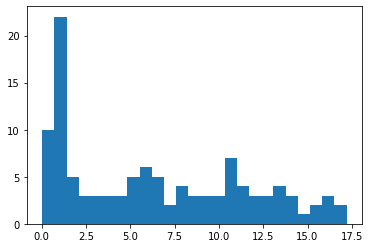

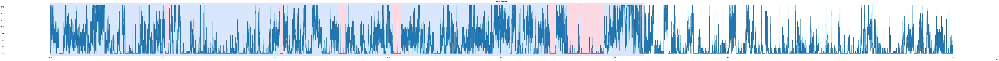

Coverage cutoff: 
18.5452415
Sample:17
23.984652042388916
threshold: 
0.8499384796191252


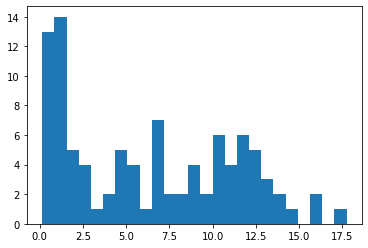

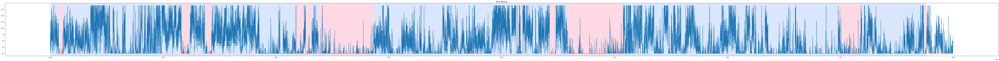

Coverage cutoff: 
19.9329885
Sample:18
23.667847156524658
threshold: 
0.868999631313752


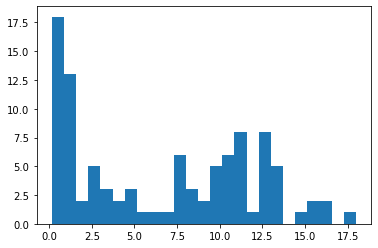

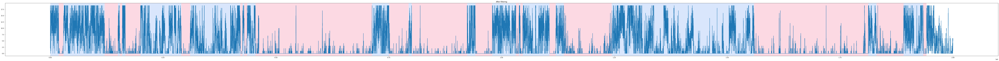

Coverage cutoff: 
19.3886059
Sample:19
23.855645179748535
threshold: 
0.781340471109822


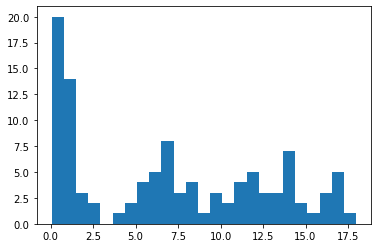

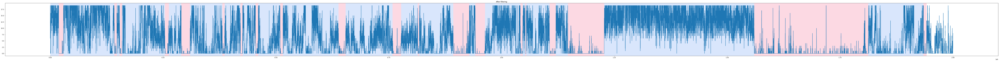

Coverage cutoff: 
19.5848022


In [123]:
calc_all_col('2mil', 10**5, 10**5, arr)

Reference: 
23.478012323379517
threshold: 
4.7457777777777785


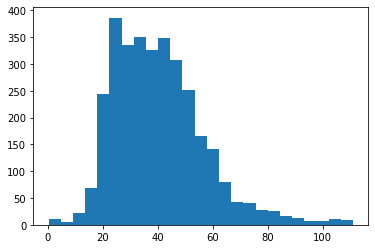

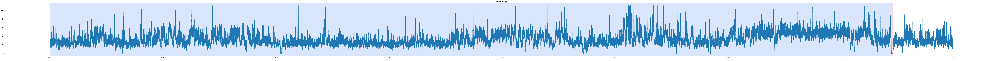

Sample:1
22.79172992706299
threshold: 
4.385876543209877


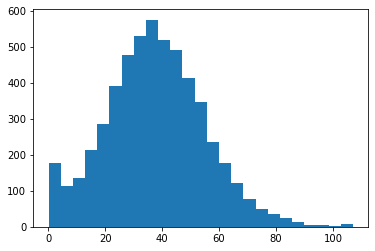

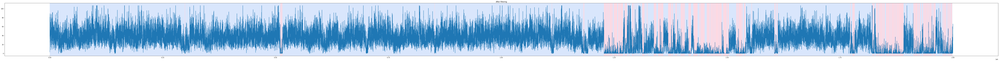

Coverage cutoff: 
107.63616529999999
Sample:2
23.39085578918457
threshold: 
1.08


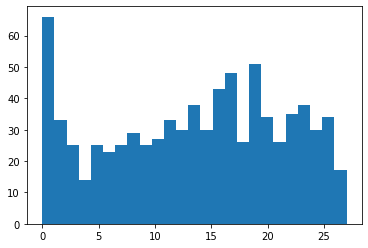

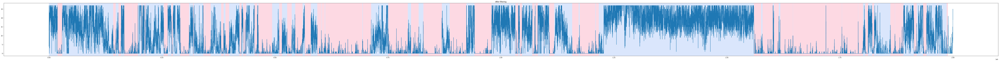

Coverage cutoff: 
27.9573035
Sample:3
23.38759708404541
threshold: 
1.1910167597765364


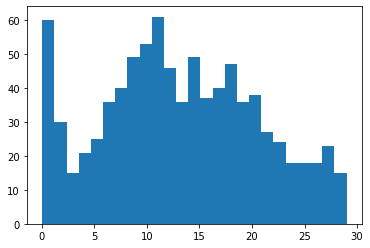

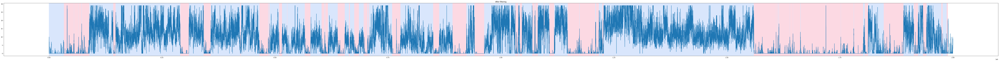

Coverage cutoff: 
29.724108700000002
Sample:4
23.311794996261597
threshold: 
1.32


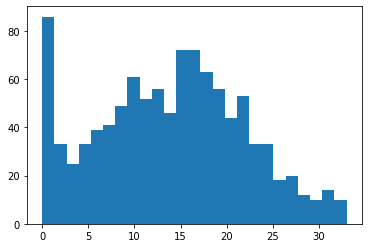

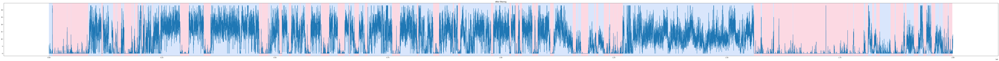

Coverage cutoff: 
33.6706412
Sample:5
23.610983848571777
threshold: 
1.1056758245276976


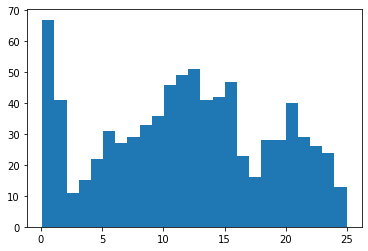

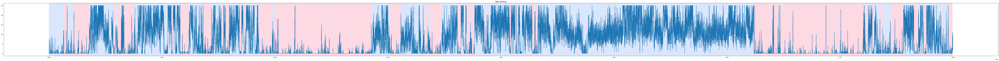

Coverage cutoff: 
25.6870093
Sample:6
23.539930820465088
threshold: 
1.3396200145032633


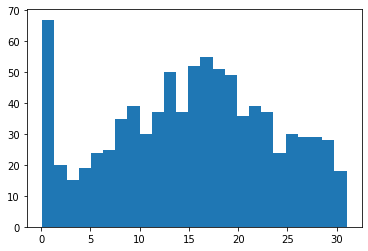

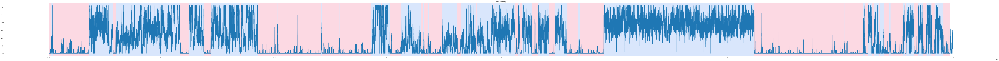

Coverage cutoff: 
31.264682
Sample:7
23.621862173080444
threshold: 
0.8642010950721752


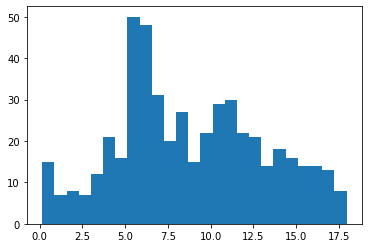

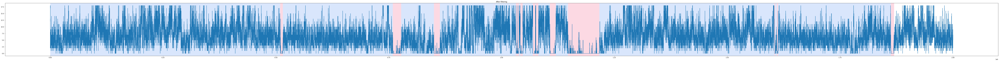

Coverage cutoff: 
18.203745599999998
Sample:8
23.43445897102356
threshold: 
0.8248247422680413


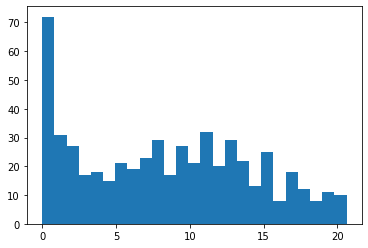

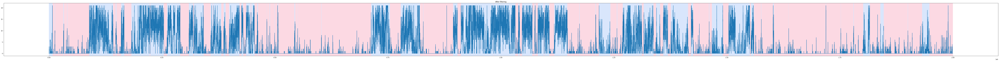

Coverage cutoff: 
21.9490434
Sample:9
23.60771894454956
threshold: 
0.794


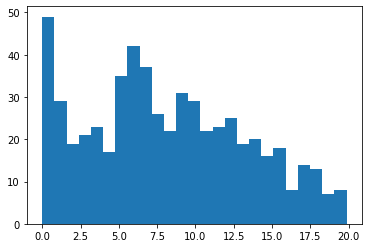

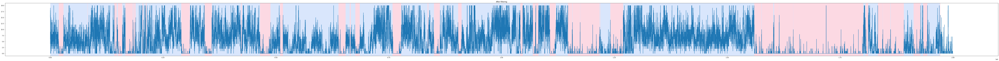

Coverage cutoff: 
20.2713991
Sample:10
23.523921966552734
threshold: 
0.96


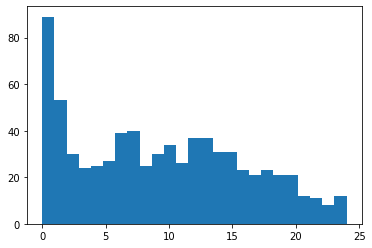

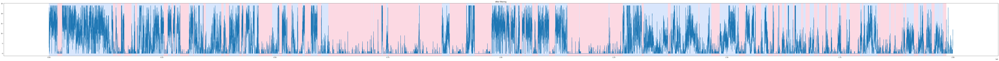

Coverage cutoff: 
24.4085848
Sample:11
24.19462013244629
threshold: 
0.7907846095936371


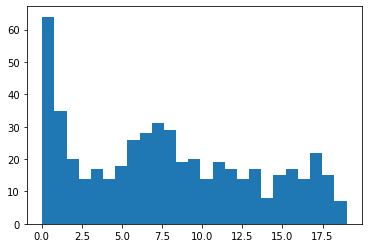

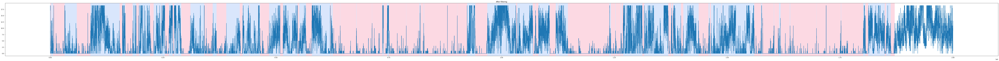

Coverage cutoff: 
19.8881604
Sample:12
24.548635959625244
threshold: 
0.6365847953216375


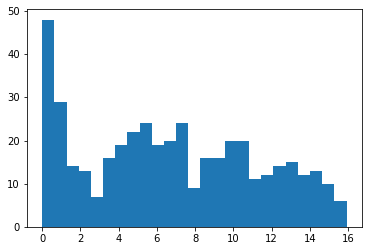

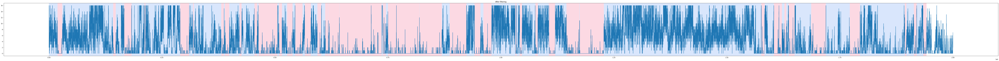

Coverage cutoff: 
16.8571126
Sample:13
24.035280227661133
threshold: 
0.7207158121576727


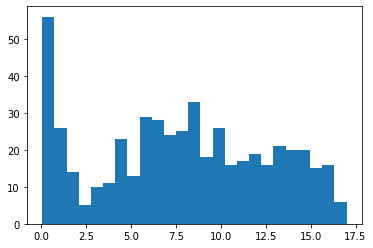

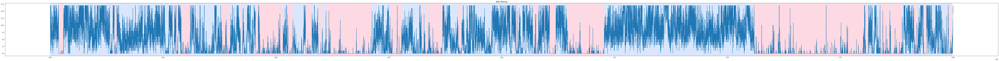

Coverage cutoff: 
17.757649
Sample:14
23.93719983100891
threshold: 
0.7192677595628415


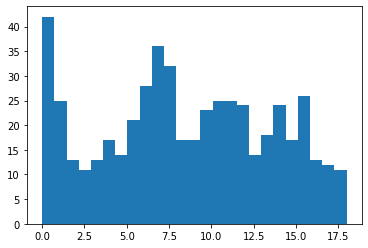

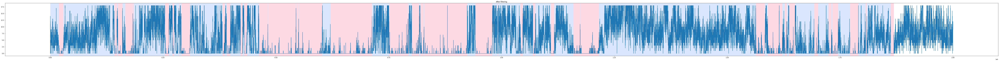

Coverage cutoff: 
18.981129799999998
Sample:15
24.50075387954712
threshold: 
0.913629090909091


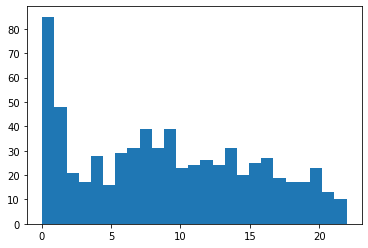

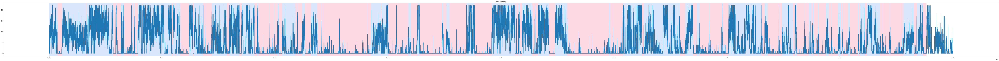

Coverage cutoff: 
22.2121067
Sample:16
24.518231868743896
threshold: 
0.72


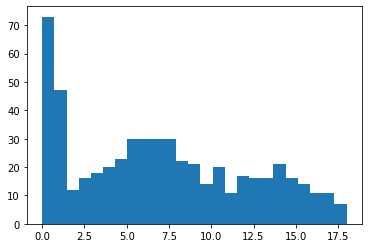

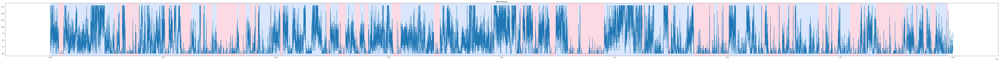

Coverage cutoff: 
18.5452415
Sample:17
24.225465059280396
threshold: 
0.7588571428571429


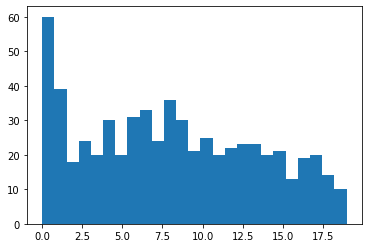

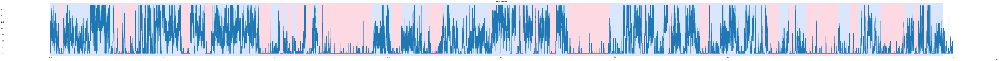

Coverage cutoff: 
19.9329885
Sample:18
24.02173376083374
threshold: 
0.76


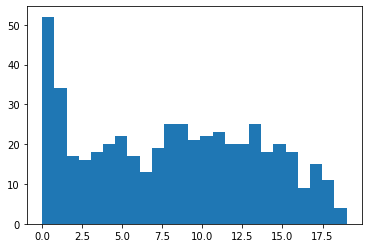

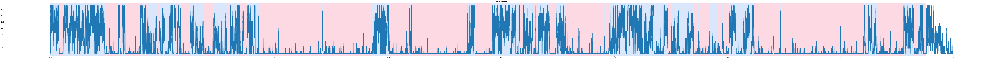

Coverage cutoff: 
19.3886059
Sample:19
24.742870092391968
threshold: 
0.7544065040650406


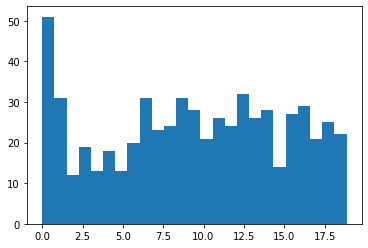

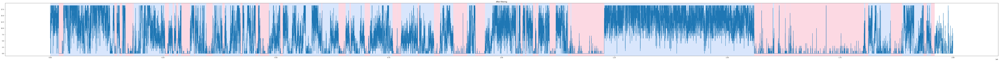

Coverage cutoff: 
19.5848022


In [124]:
calc_all_col('2mil', 10**4, 10**4, arr)

Reference: 
24.18340802192688


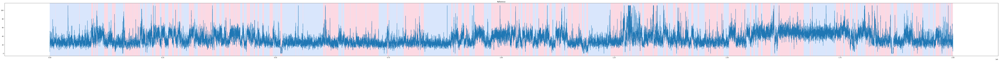

22
Sample:1
23.95633101463318


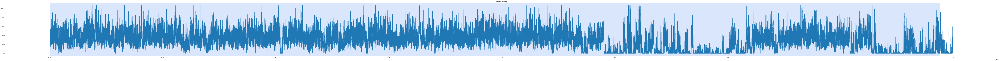

Sample:2
23.605960845947266


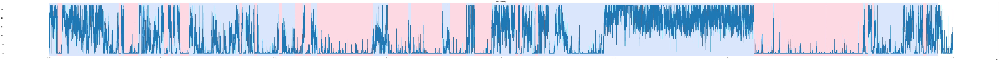

Sample:3
23.90693998336792


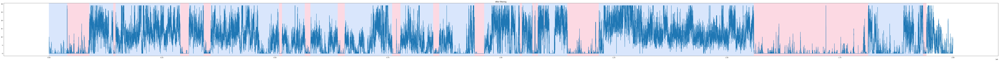

Sample:4
23.851506233215332


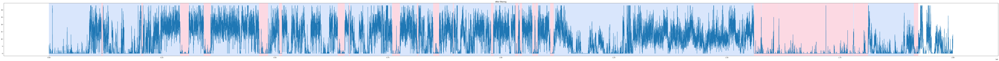

Sample:5
24.14011311531067


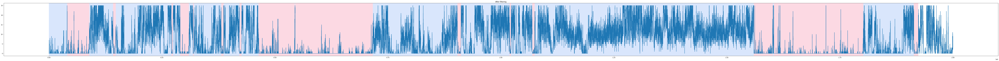

Sample:6
24.046133995056152


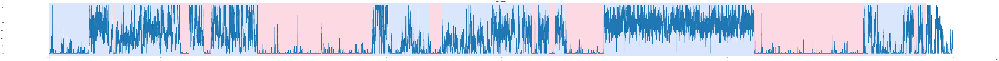

Sample:7
24.262784957885742


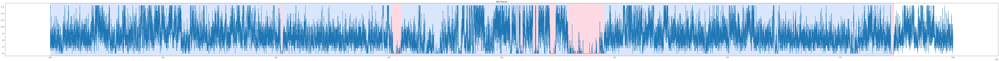

Sample:8
23.87228012084961


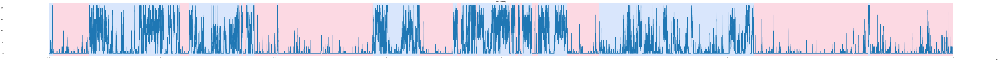

Sample:9
24.1539089679718


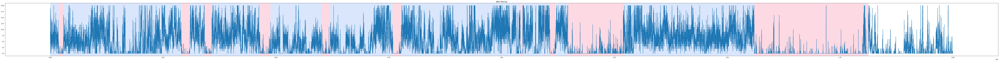

Sample:10
23.990054845809937


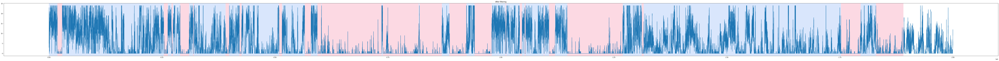

Sample:11
24.07122015953064


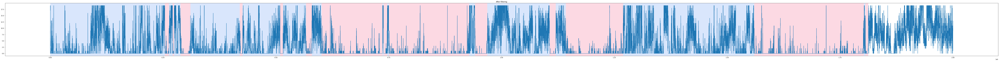

Sample:12
23.79187512397766


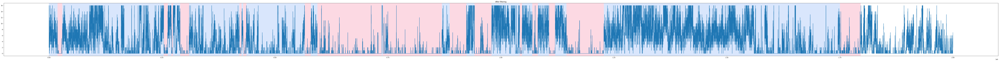

Sample:13
24.284226894378662


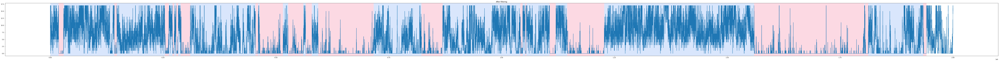

Sample:14
25.49357318878174


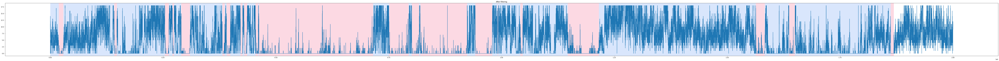

Sample:15
24.951061010360718


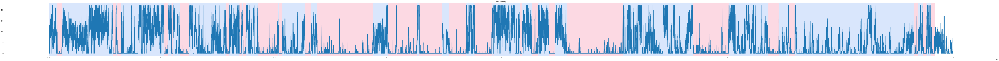

Sample:16
24.33578586578369


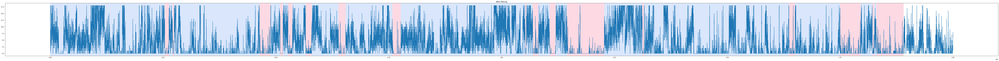

Sample:17
24.769217014312744


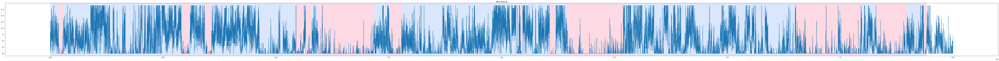

Sample:18
24.061977863311768


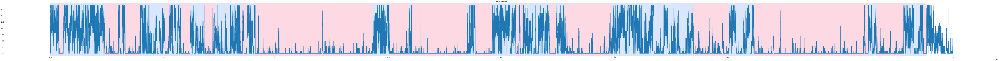

Sample:19
24.086101055145264


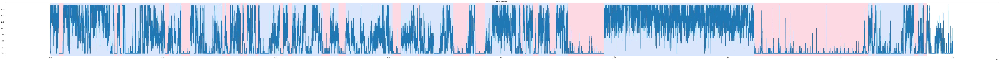

In [55]:
calc_all_col('2mil', 10**5, 10**5, 1, arr)

Reference: 
24.60733914375305


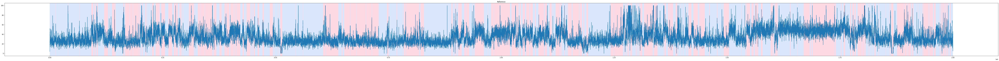

22
Sample:1
24.09192419052124


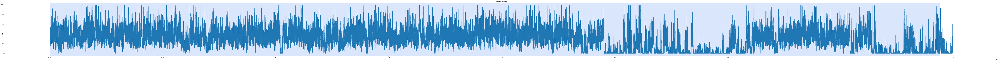

Sample:2
24.29618000984192


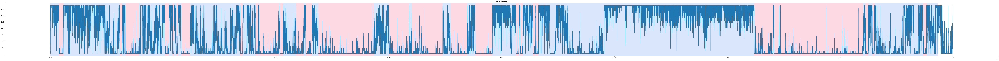

Sample:3
24.028836011886597


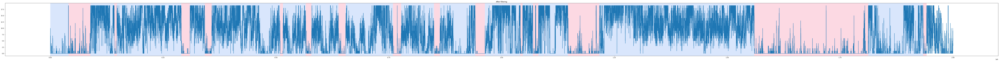

Sample:4
24.107754945755005


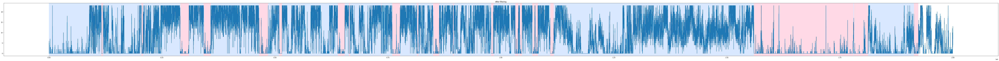

Sample:5
24.302078008651733


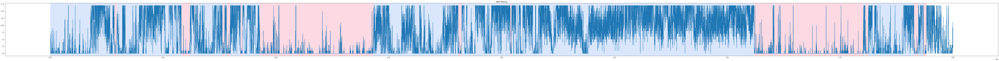

Sample:6
24.022233724594116


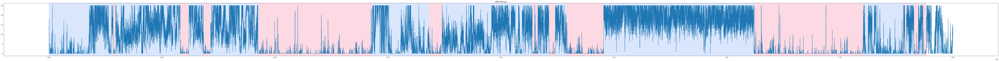

Sample:7
24.240254878997803


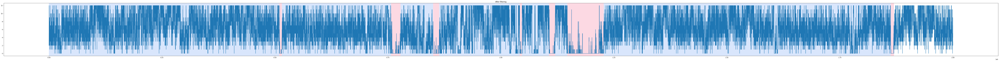

Sample:8
23.672382354736328


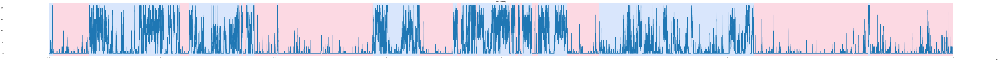

Sample:9
23.877222061157227


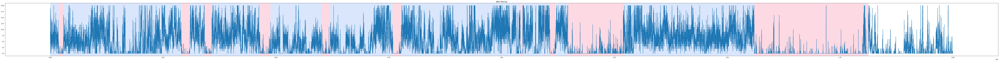

Sample:10
23.759586811065674


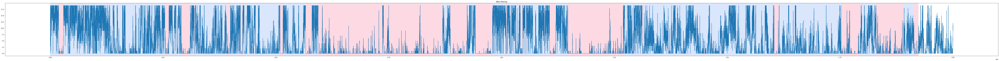

Sample:11
24.051634073257446


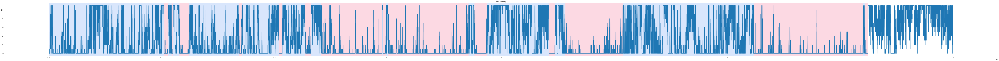

Sample:12
23.74835777282715


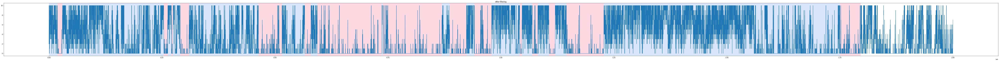

Sample:13
24.23656988143921


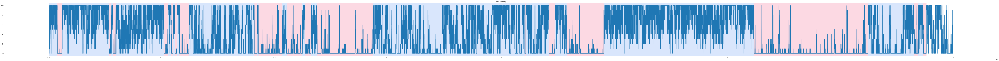

Sample:14
24.01474404335022


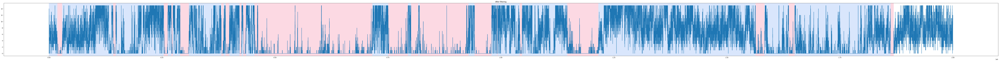

Sample:15
24.228434085845947


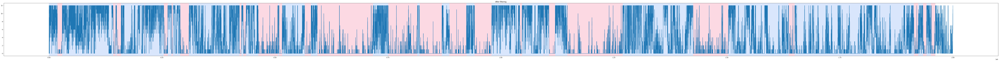

Sample:16
24.225908994674683


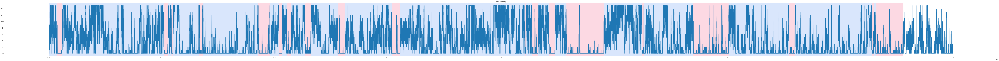

Sample:17
24.3177649974823


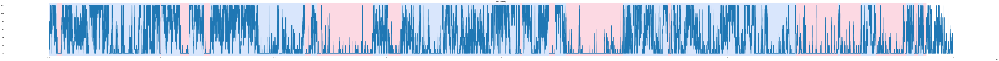

Sample:18
24.287776947021484


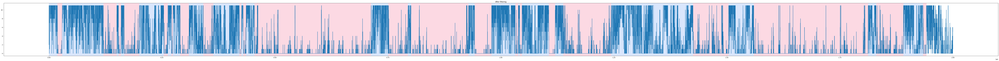

Sample:19
24.416631937026978


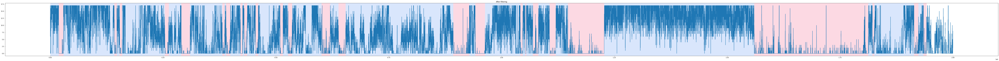

In [45]:
calc_all_col('2mil', 10**5, 10**5, 1, arr)

In [ ]:
def calc_all_col(path, pen_ref, pen_ind, threshold, arr_avg_cov): 
    
    data=pd.read_csv(path, header=None, sep='\t')
    
    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100
    
    #Extract the reference
    reference=np.array(data[2])
    reference[reference > arr_avg_cov[0]] = arr_avg_cov[0]
    #Calculate the reference 
    t0 = time.time()
    algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    t1 = time.time()
    print("Reference: ")
    print(t1-t0)
    
    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()
    print(len(data.columns))
    #Extract the individual sample
    for i in range(len(data.columns-4)):
        individual=np.array(data[i+3])
        individual[individual > arr_avg_cov[i+1] ] = arr_avg_cov[i+1]
         #Fit the data - uncommet this to try different models
        t0 = time.time()
        algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)
   
        #Predict the breakpoints for the individual and reference
        ind_bkps = algo.predict(pen=pen_ind)
        t1 = time.time()
        print("Sample:" + str(i))
        print(t1-t0)
        
        
        
        
        display_filtered(ind_bkps, individual, threshold)
       



sns.displot(penguins, x="flipper_length_mm", binwidth=3)

In [ ]:
import seaborn as sns
def arr_avg_cov_bkps(pred_arr, coverage_array):
    arr=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]

        temp=coverage_array[start: stop]

        avg_coverage=sum(temp)/len(temp)
        arr.append(avg_coverag)
        sns.displot(penguins, x="flipper_length_mm", binwidth=1)
    return arr
        